In [1]:
import os

import altair as alt
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pandas as pd
import seaborn as sns
alt.data_transformers.disable_max_rows()
from dnsmex.local import localify

# double dpi resolution
#plt.rcParams['figure.dpi'] = 2 * plt.rcParams['figure.dpi']

from netam.attention_map import attention_mapss_of
from netam.framework import load_crepe

figures_dir = localify("FIGURES_DIR")

We are going to get the attention weights using the [MultiHeadAttention](https://pytorch.org/docs/stable/generated/torch.nn.MultiheadAttention.html) module in PyTorch. These weights are

$$
\text{softmax}\left(\frac{Q K^T}{\sqrt{d_k}}\right).
$$

So this tells us that the rows of the attention map correspond to the queries, whereas the columns correspond to the keys.

In [2]:
seq_6mtx = "".join(pd.read_csv("../data/6MTX_asa.csv", index_col=0)["site_aa"])
seq_2vxs = "".join(pd.read_csv("../data/2VXS_asa.csv", index_col=0)["site_aa"])
seqs = [seq_6mtx, seq_2vxs]

In [3]:
crepe_path = "../dnsm-train/trained_models/dnsm_1m-v1jaffe+v1tang-joint"

model_name = os.path.basename(crepe_path)
model = load_crepe(crepe_path).model

from dnsmex.dnsm_zoo import create_model
#model = create_model("dnsm_1m")

model.eval()

attention_mapss = attention_mapss_of(model, seqs)
attention_maps = attention_mapss[0]
attention_maps.shape

(5, 8, 120, 120)

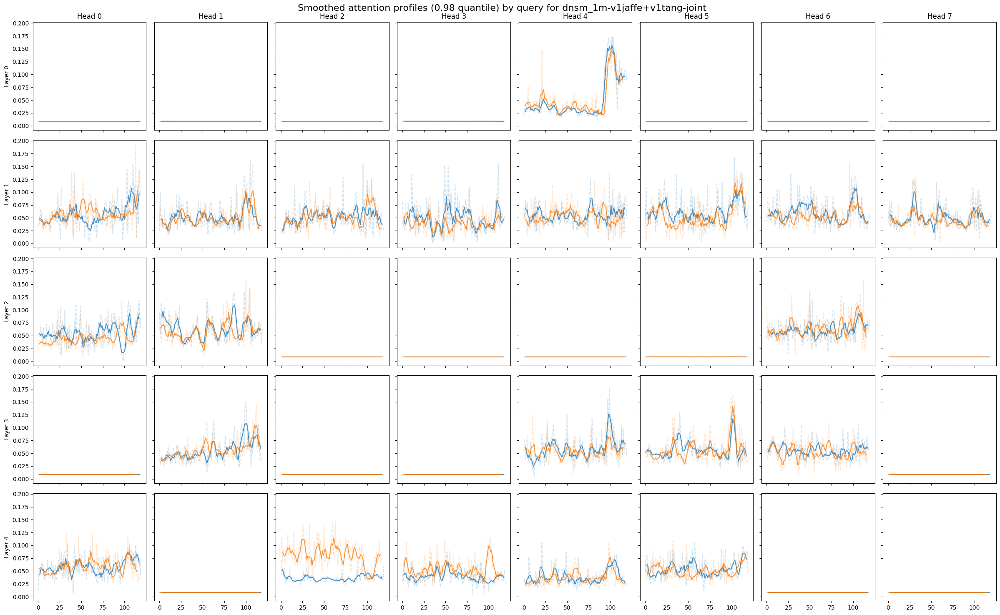

In [4]:
def plot_attention_mapss(attention_mapss, by, quantile=0.98, rolling_window=5):
    """
    Take the mean attention map by heads, then take the maximum attention
    score to get a profile indexed by `by`.

    If by="query", this will return the maximum attention score for each query position.
    If by="key", this will return the maximum attention score for each key position.
    """
    by_to_index_dict = {"query": 3, "key": 2}

    assert len(attention_mapss) > 0, "No attention maps to plot"
    
    layer_count, head_count, _, _ = attention_mapss[0].shape

    #fig, axs = plt.subplots(layer_count, head_count, figsize=(3*head_count, 3*layer_count))
    fig, axs = plt.subplots(layer_count, head_count, figsize=(3*head_count, 3*layer_count), sharex=True, sharey=True)

    if quantile == 1.0:
        quantile_description = "max"
    else:
        quantile_description = f"{quantile} quantile"
    fig.suptitle(f"Smoothed attention profiles ({quantile_description}) by {by} for {model_name}", fontsize=16)

    for seq_idx, attention_maps in enumerate(attention_mapss):
        attention_profiles = np.quantile(attention_maps, quantile, axis=by_to_index_dict[by])

        for layer_idx, layer_profiles in enumerate(attention_profiles):
            for head_idx, head_profile in enumerate(layer_profiles):
                smoothed_head_profile = pd.Series(head_profile).rolling(rolling_window, center=True).mean()
                axs[layer_idx, head_idx].plot(smoothed_head_profile, label=f"Seq {seq_idx}", color=f"C{seq_idx}", alpha=0.8)
                axs[layer_idx, head_idx].plot(head_profile, label=f"Seq {seq_idx}", color=f"C{seq_idx}", alpha=0.2, linestyle="--")

        for ax, layer_idx in zip(axs[:,0], range(layer_count)):
            ax.set_ylabel(f"Layer {layer_idx}")

        for ax, head_idx in zip(axs[0], range(head_count)):
            ax.set_title(f"Head {head_idx}")
    
    plt.tight_layout()
    
plot_attention_mapss(attention_mapss, by="query")

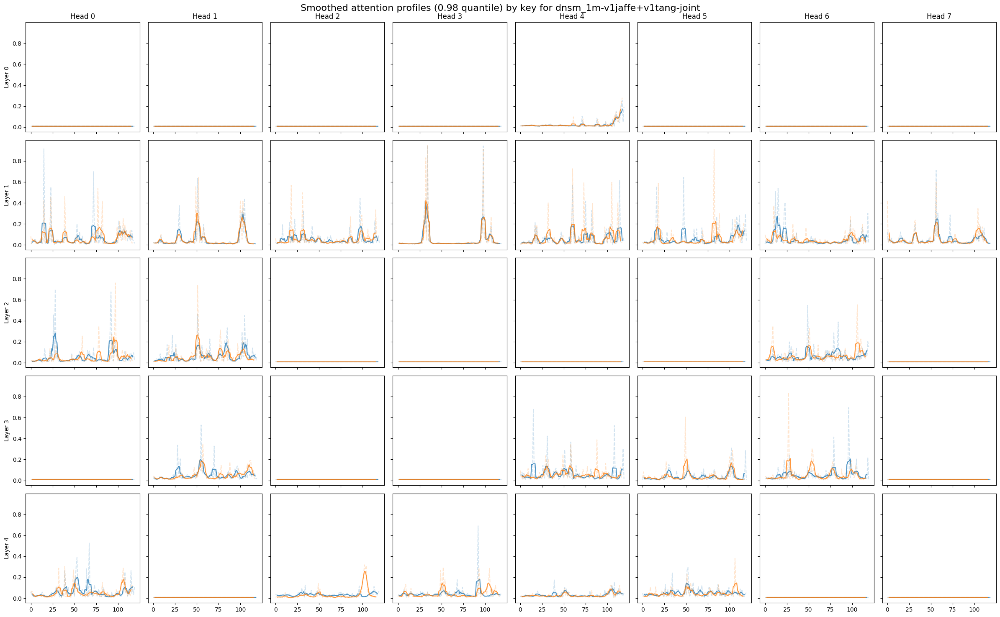

In [5]:
plot_attention_mapss(attention_mapss, by="key")

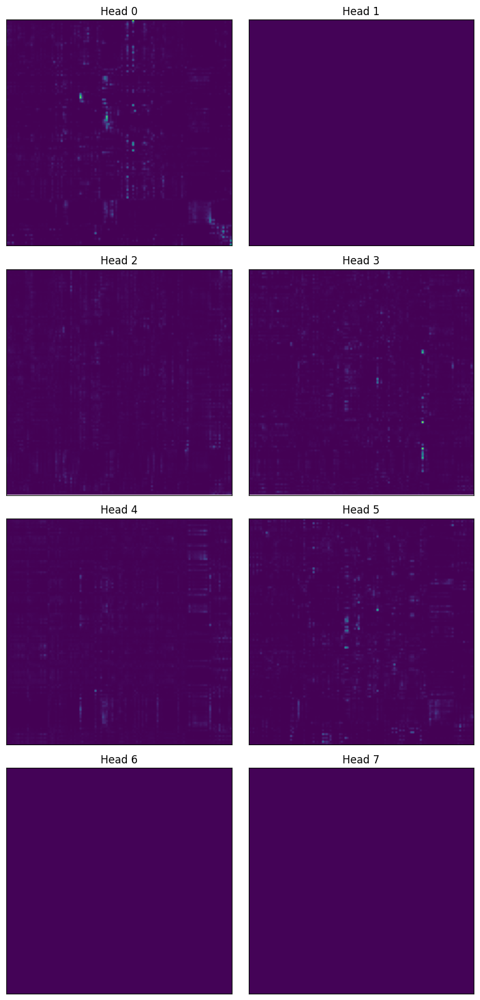

In [6]:
def plt_attention_maps_layer(attention_maps, layer=-1, same_color_scale=True):
    """
    Plot attention maps with plt.
    """
    layer_map = attention_maps[layer]
    n_heads = layer_map.shape[0]
    n_rows = (n_heads + 1) // 2  # Calculate number of rows needed for two columns

    fig, axes = plt.subplots(n_rows, 2, figsize=(8, n_rows * 4))
    axes = axes.flatten()  # Flatten the axes array for easy iteration

    if same_color_scale:
        vmin = np.min(layer_map)
        vmax = np.max(layer_map)
    else:
        vmin = vmax = None

    for i, ax in enumerate(axes):
        if i < n_heads:
            im = ax.imshow(layer_map[i], vmin=vmin, vmax=vmax)
            ax.set_title(f"Head {i}")
            ax.set_xticks([])
            ax.set_yticks([])
        else:
            ax.axis('off')  # Hide any extra subplots if n_heads is odd

    plt.tight_layout()
    plt.show()

plt_attention_maps_layer(attention_maps)

In [7]:
def plot_attention_map(attention_maps, sequence, which_head):
    single_head_attention_map = attention_maps[which_head]
    # Ensure the sequence length matches the attention map dimensions
    assert len(sequence) == single_head_attention_map.shape[0] == single_head_attention_map.shape[1], \
        "Sequence length and attention map dimensions must match"
    
    # Convert to a DataFrame
    data = []
    for i in range(single_head_attention_map.shape[0]):
        for j in range(single_head_attention_map.shape[1]):
            data.append({
                'Query Position (1-indexed)': i + 1,
                'Key Position (1-indexed)': j + 1,
                'Query Character': sequence[i],
                'Key Character': sequence[j],
                'Attention Score': single_head_attention_map[i, j]
            })

    df = pd.DataFrame(data)
    tick_values = list(range(1, len(sequence) + 1, 10))

    # Create the heatmap
    heatmap = alt.Chart(df).mark_rect().encode(
        x=alt.X('Key Position (1-indexed):O', axis=alt.Axis(title='Key Position (1-indexed)', values=tick_values)),
        y=alt.Y('Query Position (1-indexed):O', axis=alt.Axis(title='Query Position (1-indexed)', values=tick_values)),
        color=alt.Color('Attention Score:Q', scale=alt.Scale(scheme='viridis')),
        tooltip=[
            alt.Tooltip('Key Position (1-indexed):O', title='Key Position (1-indexed)'),
            alt.Tooltip('Query Position (1-indexed):O', title='Query Position (1-indexed)'),
            alt.Tooltip('Key Character:O', title='Key Character'),
            alt.Tooltip('Query Character:O', title='Query Character'),
            alt.Tooltip('Attention Score:Q', title='Attention Score')
        ]
    ).properties(
        width=600,
        height=600,
        title=f'Attention Map {which_head}'
    )

    return heatmap

In [8]:
layer_maps = attention_maps[-1]
for head in range(layer_maps.shape[0]):
    plot_attention_map(layer_maps, seq_6mtx, head).display()

alt.Chart(...)

alt.Chart(...)

alt.Chart(...)

alt.Chart(...)

alt.Chart(...)

alt.Chart(...)

alt.Chart(...)

alt.Chart(...)